In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import tensorflow as tf
from matplotlib import pyplot as plt
from nets.deeplabv3plus import DeepLabV3plus
from utils.visual import vis_segmentation
print(tf.__version__)

2.4.0


In [3]:
from utils.select_device import select_device
select_device(1)

In [4]:
train_img_hw = 512
ds, num_class = 'coco', 134
stride_ration = 16
dlv3p = DeepLabV3plus(weights=ds, input_shape=(train_img_hw, train_img_hw, 3), classes=num_class, backbone='xception', OS=stride_ration)

166461440/166458360 [==============================] - 2s 0us/step


In [5]:
# coco_weights_path = "log/deeplabv3p/20201224-070022-lr_0.0001-bs_21-NoDecay-flipped_True-rotate_True/weights-e258.ckpt"
# if ds == 'coco':
#    dlv3p.compile(optimizer='Adam')
#    dlv3p.load_weights(coco_weights_path)
#    dlv3p = tf.keras.models.load_model("log/gan/20201209-033210-lr_0.001-bs_21-NoDecay/my_model")
# print(dlv3p.summary())
# tf.keras.utils.plot_model(dlv3p, show_shapes=True)

In [6]:
dataset = tf.data.Dataset.list_files("tmp/val/coco-val/*.jpg", shuffle=False)

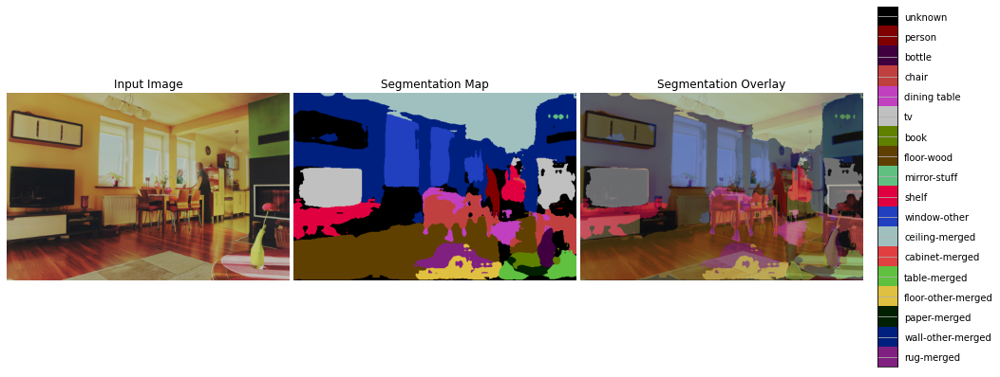

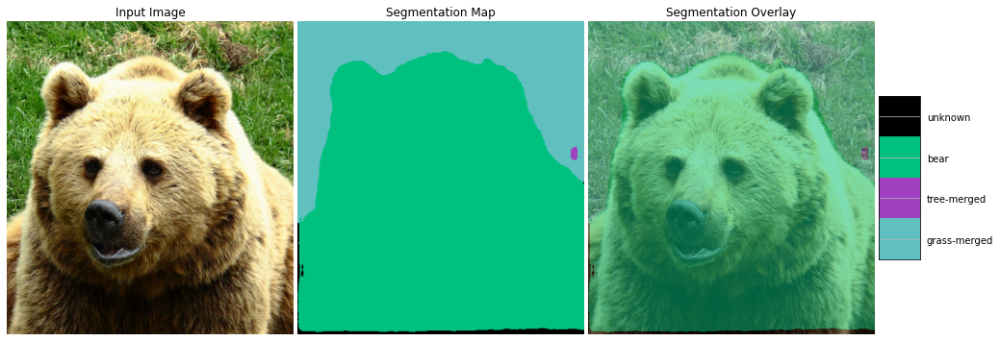

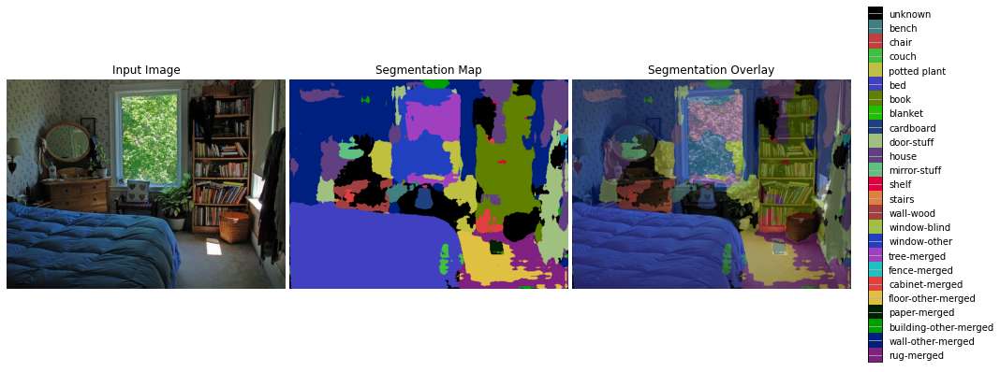

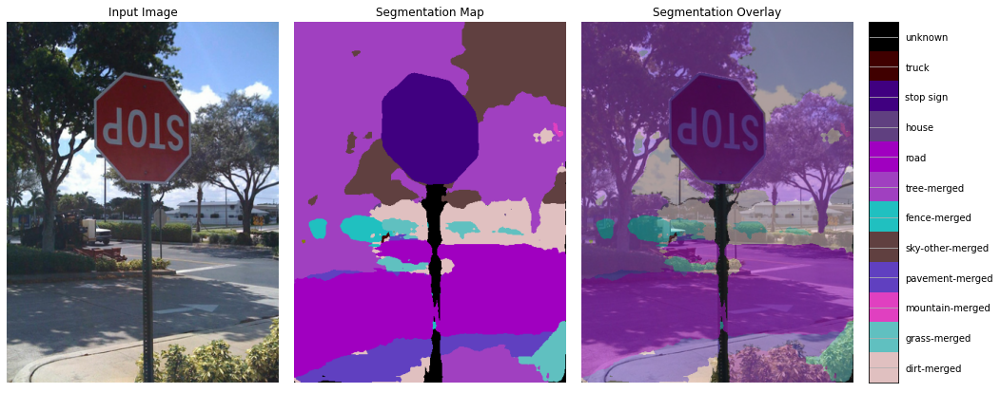

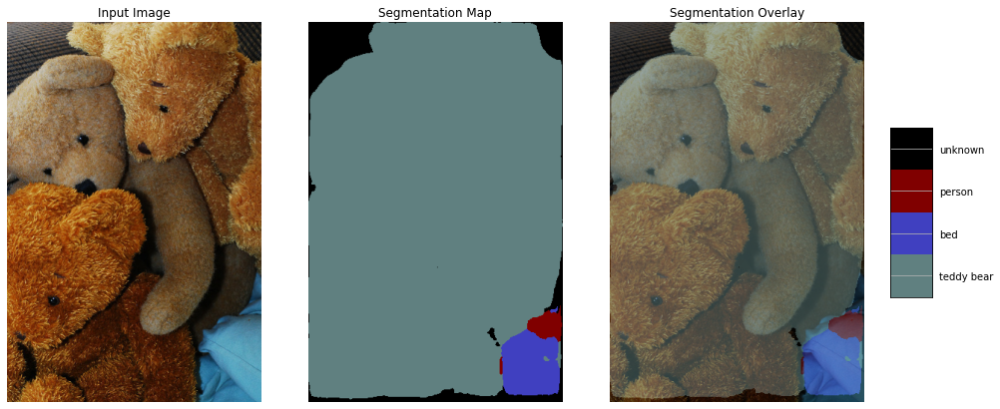

...

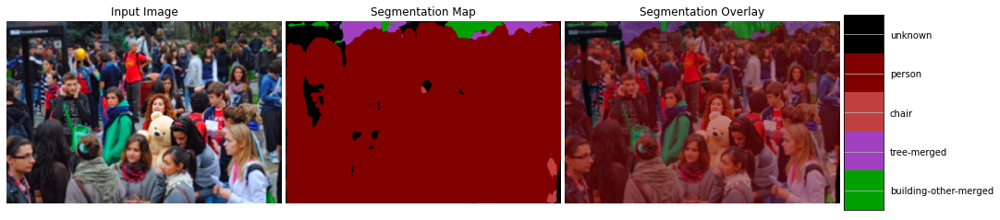

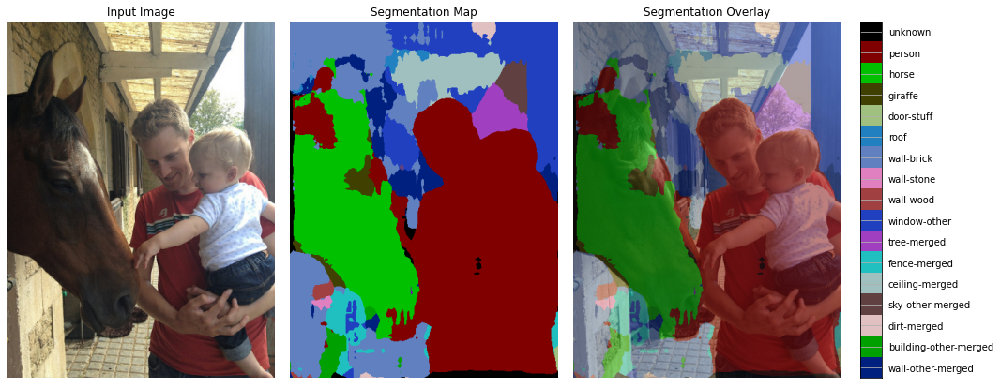

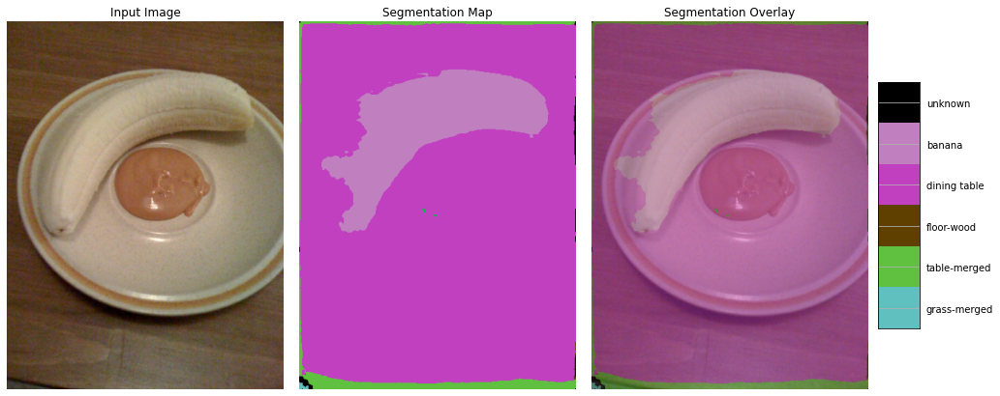

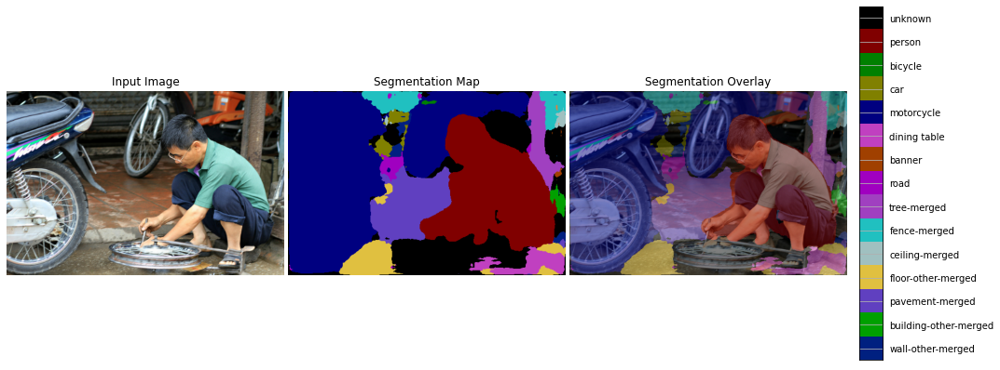

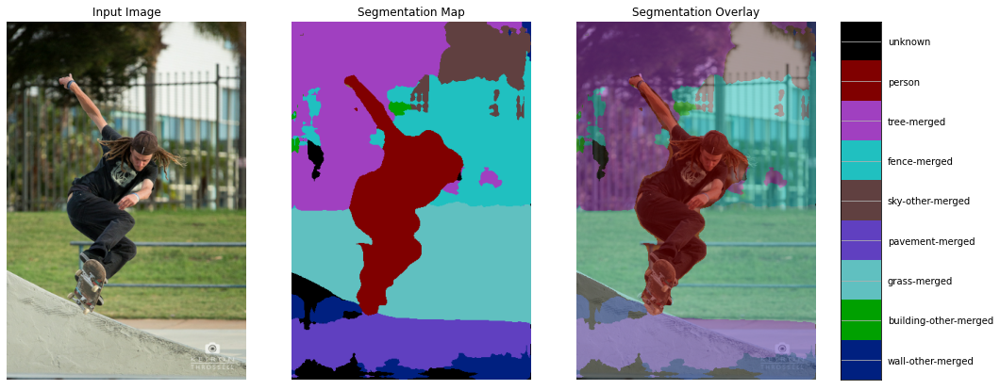

In [7]:
# Generates labels using most basic setup. Supports various image sizes.
# Returns image labels in same format as original image.
samples = dataset.take(128)
for k, img_path in enumerate(samples):
    img = tf.image.decode_image(tf.io.read_file(img_path), channels=3)

    h, w, _ = img.shape
    ratio = train_img_hw / max(h, w)
    resized_img = tf.image.resize(img, size=[int(ratio * h), int(ratio * w)])
    # ! MUST do preprocessing(normalization) for input based on specific backbone net
    if ds == 'coco':
        input_img = resized_img / 255.
    else:
        input_img = tf.keras.applications.xception.preprocess_input(resized_img)

    # pad array to square image to match training images
    pad_x = int(train_img_hw - input_img.shape[0])
    pad_y = int(train_img_hw - input_img.shape[1])
    input_img = tf.pad(input_img, ((0, pad_x), (0, pad_y), (0, 0)), mode='constant')

    # make prediction
    res = dlv3p.predict_on_batch(tf.expand_dims(input_img, 0))
    labels = tf.argmax(tf.squeeze(res), -1).numpy()

    # crop out padding and restore image back to original size
    if pad_x > 0: labels = labels[:-pad_x]
    if pad_y > 0: labels = labels[:, :-pad_y]
    # labels = tf.cast(tf.squeeze(tf.image.resize(tf.expand_dims(labels, -1), size=(h, w)), -1), tf.int32)

    vis_segmentation(tf.cast(resized_img, tf.uint8), labels, ds=ds) #, save_name=f'tmp/val/internet-e77/res/{k}.jpg')